### Step 3: Data Preprocessing

### 1. Importing Libraries and Final Data Checks
imports the necessary libraries needed for Data preprocessing

In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc
from sklearn.decomposition import PCA
import plotly.express as px
import numpy as np
from scipy.sparse import csr_matrix, vstack, hstack
from sklearn import svm
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

c:\Users\dxcas\AppData\Local\Programs\Python\Python39\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.26.1
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
data = pd.read_pickle("data/data_w_feature_eng.pkl")

In [3]:
data.isna().sum()

comment                                        0
parent_comment                                 0
label                                          0
comment_tokens                                 0
parent_comment_tokens                          0
comment_score                                  0
parent_comment_score                           0
weighted_parent_sentiment_score_neutral        0
weighted_parent_sentiment_score_positive       0
weighted_comment_sentiment_score_neutral       0
weighted_comment_sentiment_score_positive      0
comment_word_count                             0
parent_comment_word_count                      0
comment_token_count                            0
parent_comment_token_count                     0
comment_unique_word_count                      0
parent_comment_unique_word_count               0
comment_unique_token_count                     0
parent_comment_unique_token_count              0
comment_stopword_count                         0
parent_comment_stopw

Presene of NA values in mean word length and mean token length columns suggest the presence of empty tokens/comments in the dataset and this is possibly the result of the cleaning and feature engineering process.
Due to the small number of entries with NA values (~2000 or lesser) it is safe to drop these columns

In [4]:
data = data.dropna()

In [25]:
print(data.dtypes)

comment                                       object
parent_comment                                object
label                                          int64
comment_tokens                                object
parent_comment_tokens                         object
comment_score                                float64
parent_comment_score                         float64
weighted_parent_sentiment_score_neutral        uint8
weighted_parent_sentiment_score_positive       uint8
weighted_comment_sentiment_score_neutral       uint8
weighted_comment_sentiment_score_positive      uint8
comment_word_count                             int64
parent_comment_word_count                      int64
comment_token_count                            int64
parent_comment_token_count                     int64
comment_unique_word_count                      int64
parent_comment_unique_word_count               int64
comment_unique_token_count                     int64
parent_comment_unique_token_count             

### 2. Checks for Linear Separability

In [26]:
list_of_features = ['label','comment_score', 'parent_comment_score',
       'comment_word_count','parent_comment_word_count',
       'comment_token_count', 'parent_comment_token_count',
       'comment_unique_word_count', 'parent_comment_unique_word_count',
       'comment_unique_token_count', 'parent_comment_unique_token_count',
       'comment_stopword_count', 'parent_comment_stopword_count',
       'comment_mean_word_length', 'parent_comment_mean_word_length',
       'comment_mean_token_length', 'parent_comment_mean_token_length',
       'comment_char_count', 'parent_comment_char_count',
       'comment_punctuation_count', 'parent_comment_punctuation_count',
       'comment_hashtag_count', 'parent_comment_hashtag_count',
       'comment_number_count', 'parent_comment_number_count',
       'weighted_parent_sentiment_score_neutral',
       'weighted_parent_sentiment_score_positive',
       'weighted_comment_sentiment_score_neutral',
       'weighted_comment_sentiment_score_positive']
df = data[list_of_features]

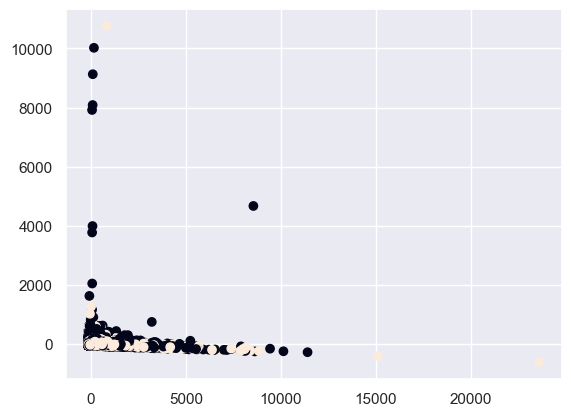

In [27]:
pca = PCA(n_components=15)
reduced_features = pca.fit_transform(df)
plt.scatter(reduced_features[:, 0], reduced_features[:, 1], c=df['label'])
plt.show()

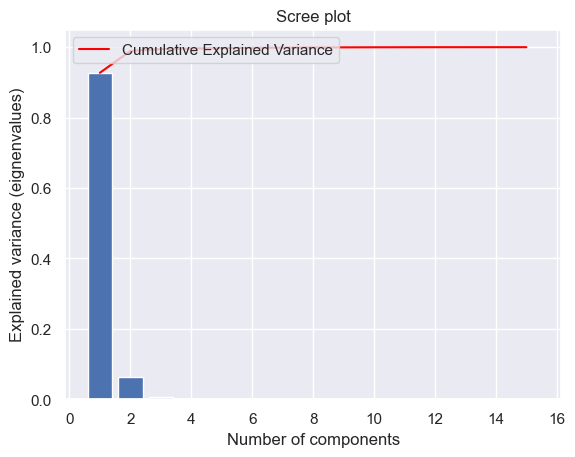

In [28]:
sns.set()
# Bar plot of explained_variance
plt.bar(
    range(1,len(pca.explained_variance_ratio_)+1),
    pca.explained_variance_ratio_
    )

plt.plot(
    range(1,len(pca.explained_variance_ratio_ )+1),
    np.cumsum(pca.explained_variance_ratio_),
    c='red',
    label='Cumulative Explained Variance')

plt.legend(loc='upper left')
plt.xlabel('Number of components')
plt.ylabel('Explained variance (eignenvalues)')
plt.title('Scree plot')

plt.show()

In [29]:
total_var = pca.explained_variance_ratio_[0:3].sum()
fig = px.scatter_3d(
    [row[0:3] for row in reduced_features], x=0, y=1, z=2, color=df['label'].astype('category'),
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)

fig.show()

In [20]:
loadings_pca1 = np.absolute(pca.components_[0])
index = np.argsort(np.absolute(loadings_pca1))
values = np.sort(np.absolute(loadings_pca1))
print("Loadings of PCA:", loadings_pca1)

Loadings of PCA: [3.96268365e-06 1.20520724e-05 9.94778073e-05 3.89178835e-03
 1.80250320e-01 2.24007909e-03 1.12869251e-01 3.36581745e-03
 1.00236655e-01 1.99414020e-03 6.60341142e-02 1.95215095e-03
 8.86050537e-02 8.39969484e-04 1.26025901e-03 6.89332786e-04
 1.13546894e-03 2.43785881e-02 9.64974366e-01 8.71488300e-04
 2.63914335e-02 1.13067945e-06 3.79517141e-05 1.93678118e-05
 9.24026542e-04 4.57172221e-04 2.78845494e-04 7.07459145e-05
 4.43078793e-05]


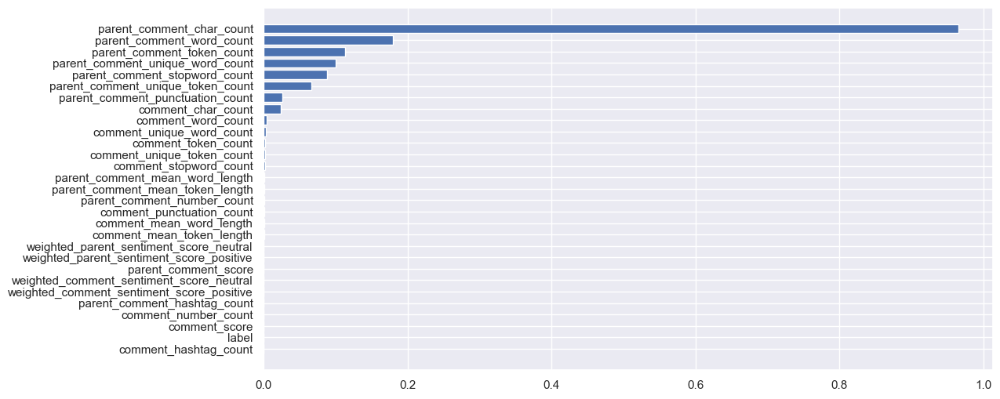

In [21]:
fig = plt.figure(figsize = [12, 6])
plt.barh(
    range(1,len(list_of_features) + 1),
    values,
    tick_label = [list_of_features[ind] for ind in index ]
    )
plt.show()

Based on Visualization, general word features are not linearly separable

In [23]:
### Linear Separability Test for BoW and tfidf
parent_tfidf_csr = vstack(data["parent_comment_tfidf"])
tfidf_csr = vstack(data["comment_tfidf"])
parent_bow_csr = vstack(data["parent_comment_bow"])
bow_csr = vstack(data["comment_bow"])
y = data['label']

In [25]:
### Testing LS for each form of data using soft margin SVM: BoW and tfidf for both comment and parent comment
for X in [parent_tfidf_csr,tfidf_csr,parent_bow_csr,bow_csr]:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Create an SVM classifier with a soft margin
    clf = svm.SVC(kernel='linear', C=1.0)

    # Train the classifier on the training data
    clf.fit(X_train, y_train)

    y_pred = clf.predict(X_test)

    # Evaluate accuracy
    accuracy = accuracy_score(y_test, y_pred)
    print(f'Accuracy: {accuracy * 100:.2f}%')

# bow no convergence, means BoW not linearly separable

Accuracy: 56.18%
Accuracy: 66.86%


In [ ]:
# Running SVM for general features
X = df.drop(columns='label')
y = df['label']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
# Create an SVM classifier with a soft margin
clf = svm.SVC(kernel='linear', C=1.0)

# Train the classifier on the training data
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

# Evaluate accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy * 100:.2f}%')

Soft SVM only able to converge for TF-IDF comments/parent comments but not for BoW comments/parent comments, indicating that the TF-IDF is more linearly separable than the BoW representation. This indicates that for our model training, we will be using TF-IDF over BoW.

Soft SVM unable to converge for general word features, further supporting the fact that the general word features are not linearly separable as well.

### 3. Checks for Dataset Balance 
generates a countplot to visually represent the distribution of labels in the dataset and prints additional information, including the total number of entries and label distribution.

Total Number of Entries before reduction: 301871
Distribution of Labels
1    151161
0    150710
Name: label, dtype: int64


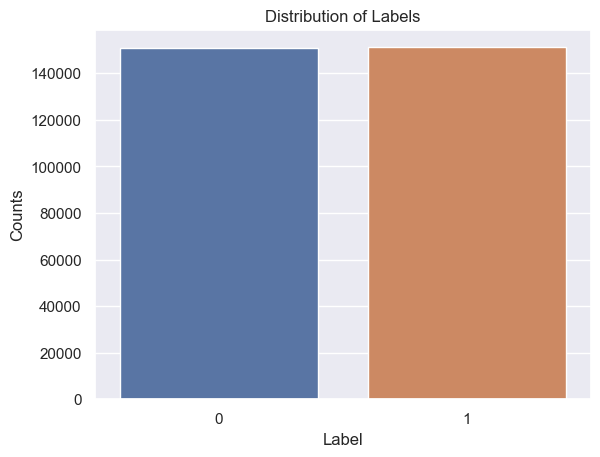

In [30]:
sns.countplot(data = data, x = "label")
plt.title("Distribution of Labels")
plt.xlabel("Label")
plt.ylabel("Counts")

print("Total Number of Entries before reduction:",len(data))
print("Distribution of Labels")
print(data["label"].value_counts())


Dataset is balanced, no balancing action required

### 4. Checks for Dimensionality 
extracts generic features by removing text-related columns and representations. It provides insights into the number of generic features and the dimensions of text representations, aiding in understanding the structure of the dataset and the complexity of the features used.

In [32]:
data_features = data.drop(['comment','parent_comment','label','comment_tokens','parent_comment_tokens'],axis=1)

In [33]:
data_features_without_bow_tfidf = data_features.drop(['comment_bow','parent_comment_bow','comment_tfidf','parent_comment_tfidf', 'comment_tfidf_nn'],axis = 1)

In [34]:
data_features_without_bow_tfidf

,comment_score,parent_comment_score,weighted_parent_sentiment_score_neutral,weighted_parent_sentiment_score_positive,weighted_comment_sentiment_score_neutral,weighted_comment_sentiment_score_positive,comment_word_count,parent_comment_word_count,comment_token_count,parent_comment_token_count,...,comment_mean_token_length,parent_comment_mean_token_length,comment_char_count,parent_comment_char_count,comment_punctuation_count,parent_comment_punctuation_count,comment_hashtag_count,parent_comment_hashtag_count,comment_number_count,parent_comment_number_count
0,0.4215,0.0000,1,0,0,1,13,5,6,4,...,4.666667,5.750000,62,38,1,4,0,0,0,0
1,0.0000,0.4767,0,1,1,0,12,26,7,16,...,5.428571,5.062500,63,128,1,3,0,0,0,0
2,0.0000,0.0000,1,0,1,0,9,14,6,5,...,7.333333,6.600000,64,75,1,0,0,0,0,0
3,0.2500,0.0000,1,0,0,1,2,6,3,7,...,5.666667,2.142857,18,34,1,3,0,0,0,0
4,-0.2960,-0.1280,1,0,0,0,26,45,15,31,...,4.066667,3.935484,128,231,3,7,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
303031,0.2263,0.0000,1,0,1,0,10,5,6,3,...,4.833333,4.333333,55,23,3,1,0,0,0,0
303032,0.4404,0.0000,1,0,0,1,6,9,3,7,...,2.666667,4.000000,22,46,1,3,0,0,0,1
303033,0.0000,0.5687,0,1,1,0,2,19,2,10,...,2.500000,4.800000,8,95,1,1,0,0,0,0
303034,0.0000,0.9582,0,1,1,0,12,122,11,78,...,3.727273,5.358974,63,703,2,13,0,0,0,0


In [35]:
print("Number of generic features:",data_features_without_bow_tfidf.shape[1])

Number of generic features: 28


In [36]:
print("Number of dimensions for bow:",data['comment_bow'][0].shape[1])# fyi: after adding bigrams and trigrams- 17805 to 43861
print("Number of dimensions for parent bow:",data['parent_comment_bow'][0].shape[1])#27187 to 102867
print("Number of dimensions for tfidf:",data['comment_tfidf'][0].shape[1])
print("Number of dimensions for parent tfidf:",data['parent_comment_tfidf'][0].shape[1])


Number of dimensions for bow: 65118
Number of dimensions for parent bow: 157467
Number of dimensions for tfidf: 65118
Number of dimensions for parent tfidf: 157467


Dimensions for BoW and tfidf too high, may need to run RFE before training each model if process takes too long.
Given the high number of dimensions for the parent tfidf representation and its weaker linear separability compared to the comment tfidf, we may decide not to use the parent tfidf for model training

### 5. Train-Test Split for Machine Learning
perform a 80-20 train-test split on the dataset, ensuring a balanced distribution of classes in both sets. It then combines the features and labels for the training and testing sets, followed by saving them as pickle files for easy retrieval and further analysis.

In [5]:
X = data.drop('label', axis = 1)
y = data['label']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, stratify = y, random_state = 42)
train = pd.concat([X_train,y_train], axis = 1)
test = pd.concat([X_test,y_test], axis = 1)
train.to_pickle("data/train.pkl")
test.to_pickle("data/test.pkl")


In [8]:
train_1 = train.drop(columns = ['parent_comment_tfidf','comment_bow', 'parent_comment_bow'])
test_1 = test.drop(columns = ['parent_comment_tfidf','comment_bow', 'parent_comment_bow'])

train_1.to_pickle('train.pkl')
test_1.to_pickle('test.pkl')

In [ ]:
train_csv = train[['label','comment']]
test_csv = test[['label','comment']]

In [ ]:
train_csv.to_csv('data/train.csv')
test_csv.to_csv('data/test.csv')